##U-net Architecture

Many deep learning architectures have been proposed to solve various image processing challenges. Some of the well known architectures include LeNet, ALexNet, VGG, and Inception. U-net is a relatively new architecture proposed by Ronneberger et al. for semantic image segmentation. This code explains the U-Net architecture; a good understanding is essential before coding. 

Link to the original U-Net paper: https://arxiv.org/abs/1505.04597


Video tutorial: https://www.youtube.com/watch?v=azM57JuQpQI


Keras U-net: https://keras.io/examples/vision/oxford_pets_image_segmentation/#what-does-one-input-image-and-corresponding-segmentation-mask-look-like

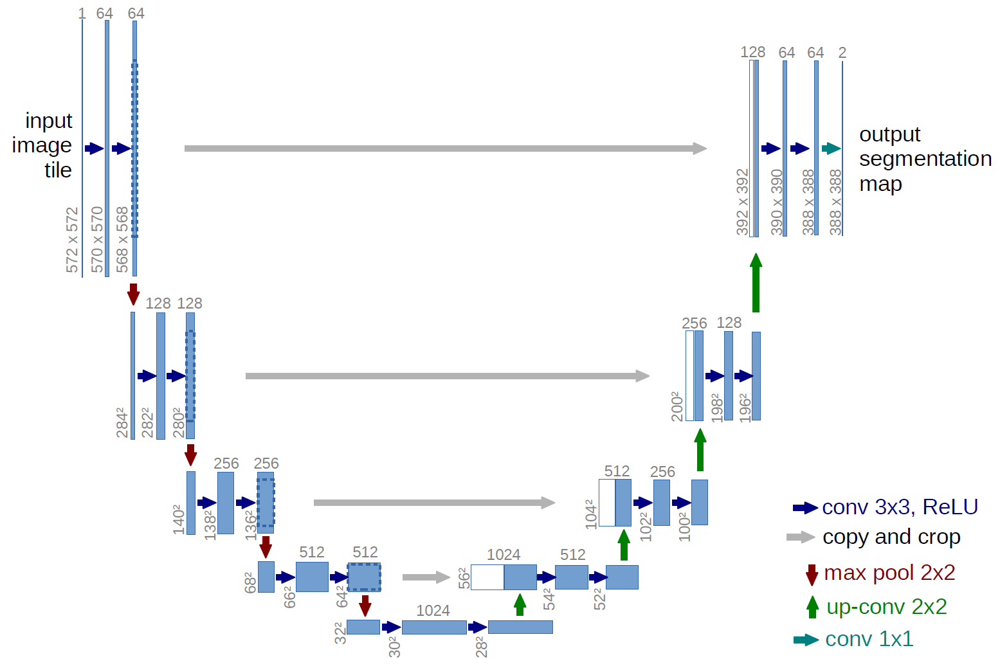

##Data Collection

In [ ]:
!curl -O https://www.robots.ox.ac.uk/~vgg/data/pets/data/images.tar.gz
!curl -O https://www.robots.ox.ac.uk/~vgg/data/pets/data/annotations.tar.gz
!tar -xf images.tar.gz
!tar -xf annotations.tar.gz

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  755M  100  755M    0     0  28.1M      0  0:00:26  0:00:26 --:--:-- 29.5M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 18.2M  100 18.2M    0     0  10.9M      0  0:00:01  0:00:01 --:--:-- 10.9M


##Importing Libraries

In [ ]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image, display
from tqdm import tqdm 
from skimage.io import imread, imshow
from skimage.transform import resize
import PIL
from PIL import Image as Im
from PIL import ImageOps

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing import image as tf_image

## Variables

In [ ]:
input_dir = "images/"
target_dir = "annotations/trimaps/"
IMG_WIDTH = 256
IMG_HEIGHT = 256
IMG_CHANNELS = 3
img_size = (IMG_WIDTH, IMG_HEIGHT)
num_classes = 3
batch_size = 32
epochs = 25

##Image Set

In [ ]:
input_img_paths = sorted(
    [
        os.path.join(input_dir, fname)
        for fname in os.listdir(input_dir)
        if fname.endswith(".jpg")
    ]
)
target_img_paths = sorted(
    [
        os.path.join(target_dir, fname)
        for fname in os.listdir(target_dir)
        if fname.endswith(".png") and not fname.startswith(".")
    ]
)

print("Number of samples:", len(input_img_paths))

for input_path, target_path in zip(input_img_paths[:10], target_img_paths[:10]):
    print(input_path, "|", target_path)

Number of samples: 7390
images/Abyssinian_1.jpg | annotations/trimaps/Abyssinian_1.png
images/Abyssinian_10.jpg | annotations/trimaps/Abyssinian_10.png
images/Abyssinian_100.jpg | annotations/trimaps/Abyssinian_100.png
images/Abyssinian_101.jpg | annotations/trimaps/Abyssinian_101.png
images/Abyssinian_102.jpg | annotations/trimaps/Abyssinian_102.png
images/Abyssinian_103.jpg | annotations/trimaps/Abyssinian_103.png
images/Abyssinian_104.jpg | annotations/trimaps/Abyssinian_104.png
images/Abyssinian_105.jpg | annotations/trimaps/Abyssinian_105.png
images/Abyssinian_106.jpg | annotations/trimaps/Abyssinian_106.png
images/Abyssinian_107.jpg | annotations/trimaps/Abyssinian_107.png


This is original image:  images/Abyssinian_105.jpg


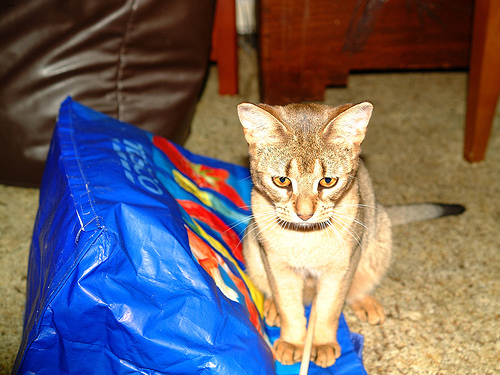

This is annotated image:  annotations/trimaps/Abyssinian_105.png


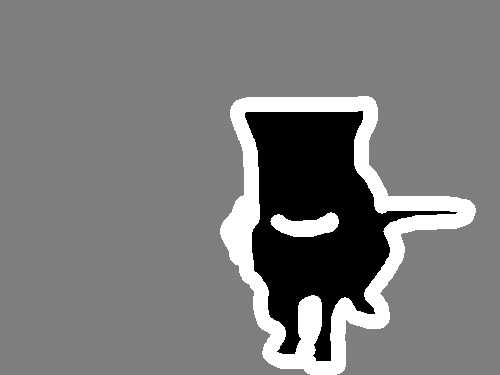

In [ ]:
# Display input image #7
img_example = 7

print("This is original image: ", input_img_paths[img_example])
display(Image(filename=input_img_paths[img_example]))

# Display auto-contrast version of corresponding target (per-pixel categories)
print("This is annotated image: ", target_img_paths[img_example])
img = PIL.ImageOps.autocontrast(load_img(target_img_paths[img_example]))
display(img)

In [ ]:
class OxfordPets(tf.keras.utils.Sequence):
    """Helper to iterate over the data (as Numpy arrays)."""

    def __init__(self, batch_size, img_size, input_img_paths, target_img_paths):
        self.batch_size = batch_size
        self.img_size = img_size
        self.input_img_paths = input_img_paths
        self.target_img_paths = target_img_paths

    def __len__(self):
        return len(self.target_img_paths) // self.batch_size

    def __getitem__(self, idx):
        """Returns tuple (input, target) correspond to batch #idx."""
        i = idx * self.batch_size
        batch_input_img_paths = self.input_img_paths[i : i + self.batch_size]
        batch_target_img_paths = self.target_img_paths[i : i + self.batch_size]
        x = np.zeros((self.batch_size,) + self.img_size + (3,), dtype="float32")
        for j, path in enumerate(batch_input_img_paths):
            img = load_img(path, target_size=self.img_size)
            x[j] = img
        y = np.zeros((self.batch_size,) + self.img_size + (1,), dtype="uint8")
        for j, path in enumerate(batch_target_img_paths):
            img = load_img(path, target_size=self.img_size, color_mode="grayscale")
            y[j] = np.expand_dims(img, 2)
            # Ground truth labels are 1, 2, 3. Subtract one to make them 0, 1, 2:
            y[j] -= 1
        return x, y

##Spliting the data

In [ ]:
# Split our img paths into a training, a validation and a test set
val_samples = 1000
test_samples = 100
random.Random(1337).shuffle(input_img_paths)
random.Random(1337).shuffle(target_img_paths)
train_input_img_paths = input_img_paths[:-val_samples]
train_target_img_paths = target_img_paths[:-val_samples]
val_input_img_paths = input_img_paths[-val_samples:]
val_target_img_paths = target_img_paths[-val_samples:]
test_input_img_paths = train_input_img_paths[-test_samples:]
test_target_img_paths = train_target_img_paths[-test_samples:]

# Instantiate data Sequences for each split
train_gen = OxfordPets(batch_size, img_size, train_input_img_paths, train_target_img_paths)
val_gen = OxfordPets(batch_size, img_size, val_input_img_paths, val_target_img_paths)
test_gen = OxfordPets(batch_size, img_size, test_input_img_paths, test_target_img_paths)

##Building a simple u-net model

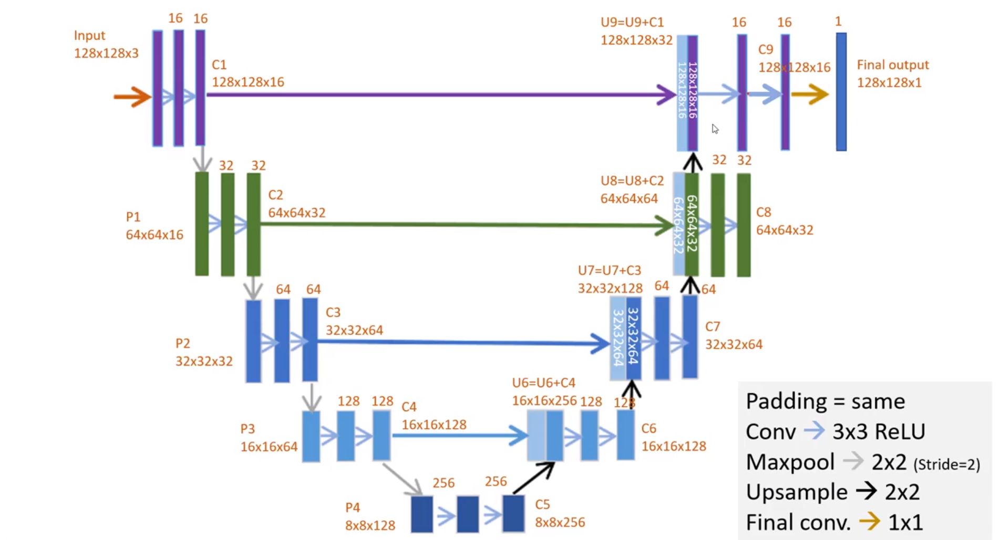

In [ ]:
def build_model():
  inputs = tf.keras.layers.Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
  

#Contraction path,  encoder
  c1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(inputs) # 16 feature spaces
  c1 = tf.keras.layers.Dropout(0.1)(c1)
  c1 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1)
  p1 = tf.keras.layers.MaxPooling2D((2, 2))(c1)

  c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1)
  c2 = tf.keras.layers.Dropout(0.1)(c2)
  c2 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2)
  p2 = tf.keras.layers.MaxPooling2D((2, 2))(c2)
 
  c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2)
  c3 = tf.keras.layers.Dropout(0.2)(c3)
  c3 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3)
  p3 = tf.keras.layers.MaxPooling2D((2, 2))(c3)
 
  c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3)
  c4 = tf.keras.layers.Dropout(0.2)(c4)
  c4 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4)
  p4 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(c4)
 
  c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4)
  c5 = tf.keras.layers.Dropout(0.3)(c5)
  c5 = tf.keras.layers.Conv2D(256, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)

#Expansive path, decoder 
  u6 = tf.keras.layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5)
  u6 = tf.keras.layers.concatenate([u6, c4])
  c6 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6)
  c6 = tf.keras.layers.Dropout(0.2)(c6)
  c6 = tf.keras.layers.Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)
 
  u7 = tf.keras.layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6)
  u7 = tf.keras.layers.concatenate([u7, c3])
  c7 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7)
  c7 = tf.keras.layers.Dropout(0.2)(c7)
  c7 = tf.keras.layers.Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)
 
  u8 = tf.keras.layers.Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7)
  u8 = tf.keras.layers.concatenate([u8, c2])
  c8 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8)
  c8 = tf.keras.layers.Dropout(0.1)(c8)
  c8 = tf.keras.layers.Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)
 
  u9 = tf.keras.layers.Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8)
  u9 = tf.keras.layers.concatenate([u9, c1], axis=3)
  c9 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9)
  c9 = tf.keras.layers.Dropout(0.1)(c9)
  c9 = tf.keras.layers.Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)
 
# Add a per-pixel classification layer
  outputs = layers.Conv2D(num_classes, 3, activation="softmax", padding="same")(c9)

# Define the model
  model = tf.keras.Model(inputs=[inputs], outputs=[outputs])
  return model
  

##Model Summary

In [ ]:
# Free up RAM in case the model definition cells were run multiple times
tf.keras.backend.clear_session()

# Build model
model = build_model()
# Configure the model for training.
# We use the "sparse" version of categorical_crossentropy
# because our target data is integers.
model.compile(optimizer="rmsprop", loss="sparse_categorical_crossentropy")
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 16) 448         input_1[0][0]                    
__________________________________________________________________________________________________
dropout (Dropout)               (None, 256, 256, 16) 0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 256, 256, 16) 2320        dropout[0][0]                    
______________________________________________________________________________________________

##Train the model

In [ ]:
callbacks = [
    tf.keras.callbacks.ModelCheckpoint("u-net.h5", verbose=1, save_best_only=True),
    tf.keras.callbacks.EarlyStopping(patience=3, monitor='val_loss'),
    tf.keras.callbacks.TensorBoard(log_dir='logs')
]
history = model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks)

Epoch 1/25
199/199 [==============================] - 175s 687ms/step - loss: 1.9045 - val_loss: 0.8933

Epoch 00001: val_loss improved from inf to 0.89333, saving model to u-net.h5
Epoch 2/25
199/199 [==============================] - 136s 681ms/step - loss: 0.8232 - val_loss: 0.7481

Epoch 00002: val_loss improved from 0.89333 to 0.74812, saving model to u-net.h5
Epoch 3/25
199/199 [==============================] - 136s 681ms/step - loss: 0.7133 - val_loss: 0.6551

Epoch 00003: val_loss improved from 0.74812 to 0.65511, saving model to u-net.h5
Epoch 4/25
199/199 [==============================] - 136s 681ms/step - loss: 0.6267 - val_loss: 0.6106

Epoch 00004: val_loss improved from 0.65511 to 0.61060, saving model to u-net.h5
Epoch 5/25
199/199 [==============================] - 136s 682ms/step - loss: 0.5643 - val_loss: 0.5290

Epoch 00005: val_loss improved from 0.61060 to 0.52901, saving model to u-net.h5
Epoch 6/25
199/199 [==============================] - 136s 681ms/step - lo

##History

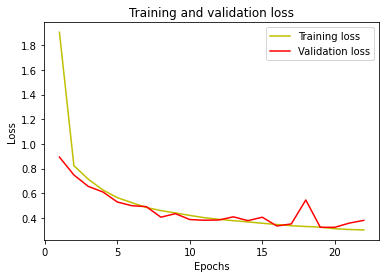

In [ ]:
#plot the training and validation accuracy and loss at each epoch
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

##Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
from tensorboard import notebook
notebook.list() # View open TensorBoard instances
notebook.display(port=6006, height=1000) 

Known TensorBoard instances:
  - port 6006: logdir logs (started 0:00:00 ago; pid 558)
Selecting TensorBoard with logdir logs (started 0:00:00 ago; port 6006, pid 558).


<IPython.core.display.Javascript object>

##Test image

Testing Image


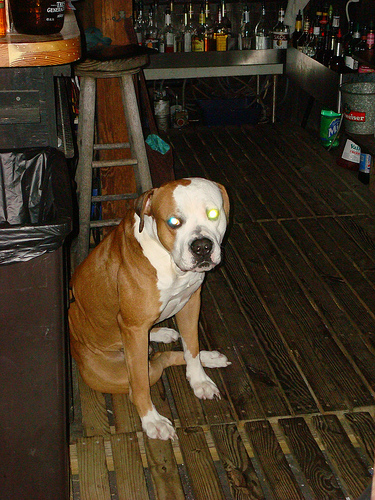

Testing Label


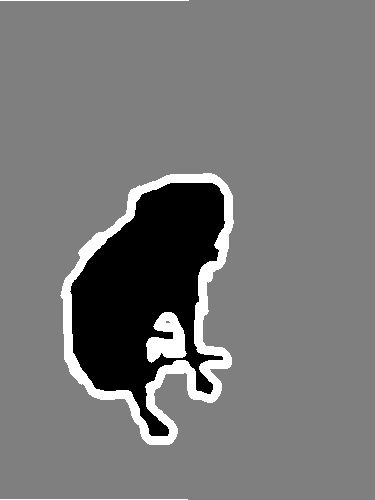

Prediction on test image


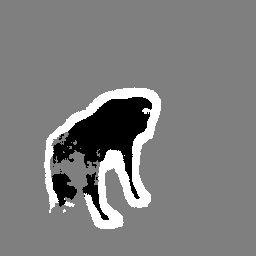

In [ ]:
# Generate predictions for all images in the validation set

test_gen = OxfordPets(batch_size, img_size, test_input_img_paths, test_target_img_paths)
test_preds = model.predict(test_gen)


def display_mask(i):
    """Quick utility to display a model's prediction."""
    mask = np.argmax(test_preds[i], axis=-1)
    mask = np.expand_dims(mask, axis=-1)
    img = PIL.ImageOps.autocontrast(tf.keras.preprocessing.image.array_to_img(mask))
    print('Prediction on test image')
    display(img)


# Display results for test image #10
i = 80

# Display input image
print('Testing Image')
display(Image(filename=test_input_img_paths[i]))

# Display ground-truth target mask
img = PIL.ImageOps.autocontrast(load_img(test_target_img_paths[i]))
print('Testing Label')
display(img)

# Display mask predicted by our model
display_mask(i)  # Note that the model only sees inputs at 150x150.

##Load Model

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
model = tf.keras.models.load_model('/content/drive/MyDrive/U-net/u-net.h5') 

Example image:

https://www.google.com/url?sa=i&url=https%3A%2F%2Fcommons.wikimedia.org%2Fwiki%2FFile%3ABengal_cat%2C_five_months_old_(2474931892).jpg&psig=AOvVaw1CJtKyXbpMuWbC4wPOidJK&ust=1622083640076000&source=images&cd=vfe&ved=2ahUKEwjTmsnKqubwAhUE0WEKHTJzAx4Qr4kDegUIARC3AQ

Input image:


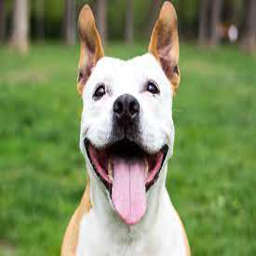

Output image:


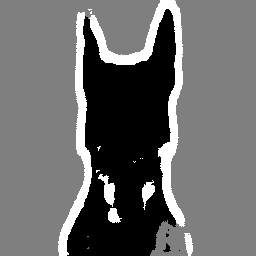

In [ ]:
from tensorflow.keras.preprocessing import image
file_name = '/content/dog.jpg' 
test_img = Im.open('/content/dog.jpg')
test_img = test_img.resize((256, 256))
img = image.load_img(file_name, target_size=(256,256))
img_array = image.img_to_array(img)
img_array_expanded_dims = np.expand_dims(img_array, axis=0)
predicted_img = model.predict(img_array_expanded_dims)
mask = np.argmax(predicted_img, axis=-1)
mask = np.expand_dims(mask, axis=-1)
mask = mask[0,:,:,:]
img = PIL.ImageOps.autocontrast(tf.keras.preprocessing.image.array_to_img(mask))
print("Input image:")
display(test_img)
print("Output image:")
display(img)


##Result

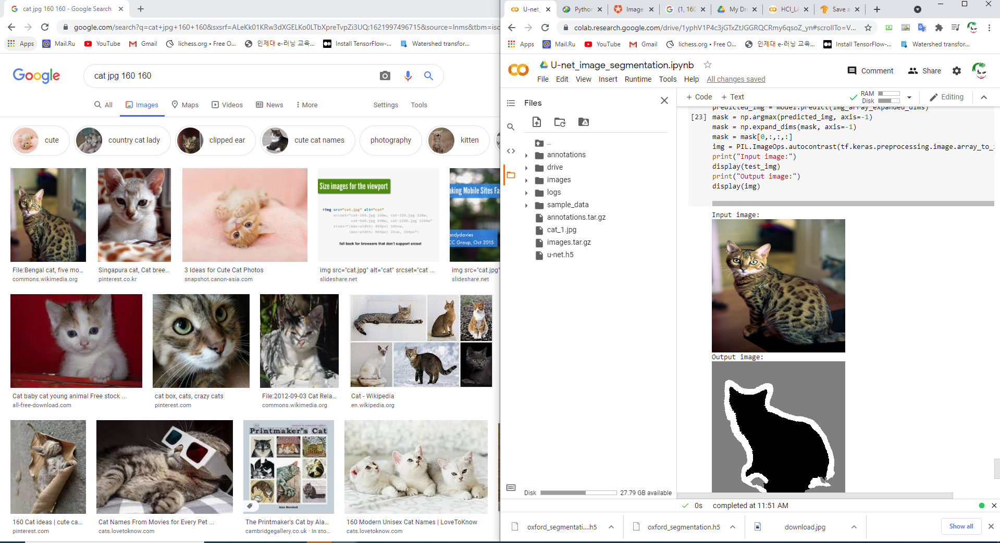